<a href="https://colab.research.google.com/github/tololojo/AML_FinalProject/blob/master/get_imagetiles.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import math
import pandas as pd
import requests
from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
from pyproj import Proj, Transformer
import random
from tqdm import tqdm
import folium
from folium.plugins import MarkerCluster


**SwisstopoTileFetcher Class**

This class facilitates fetching map tiles from the Swisstopo WMTS service. It converts geographic coordinates (latitude and longitude) into tile indices, constructs the appropriate URL for the tile image, and downloads the image. The class also provides a method to display the fetched tile image using matplotlib.

Key Methods:

*   **lat_lon_to_tile_indices():** Converts latitude and longitude to tile indices based on the zoom level.
*   **fetch_tile():** Downloads the tile image from Swisstopo.
*   **show_tile():** Displays the fetched tile image.

Parameters:



*   **longitude:** The longitude of the point for which the tile is to be fetched.
*   **latitude:** The latitude of the point for which the tile is to be fetched.
*   **zoom_level:** The zoom level for the map tile.


In [ ]:
class SwisstopoTileFetcher:
    def __init__(self, longitude, latitude, zoom_level):
        self.scheme = "https"
        self.server_name = "wmts0.geo.admin.ch"  # Can be wmts0 to wmts9
        self.version = "1.0.0"
        self.layer_name = "ch.swisstopo.swissimage"
        self.style_name = "default"
        self.time = "current"
        self.tile_matrix_set = "3857"
        self.format_extension = "jpeg"
        self.longitude = longitude
        self.latitude = latitude
        self.zoom_level = zoom_level

    def lat_lon_to_tile_indices(self):
        n = 2 ** self.zoom_level
        lat_rad = math.radians(self.latitude)
        x_tile = int((self.longitude + 180.0) / 360.0 * n)
        y_tile = int((1.0 - math.log(math.tan(lat_rad) + (1 / math.cos(lat_rad))) / math.pi) / 2.0 * n)
        return x_tile, y_tile

    def fetch_tile(self):
        # Convert coordinates to tile indices
        x, y = self.lat_lon_to_tile_indices()

        # Construct the URL
        url = f"{self.scheme}://{self.server_name}/{self.version}/{self.layer_name}/{self.style_name}/{self.time}/{self.tile_matrix_set}/{self.zoom_level}/{x}/{y}.{self.format_extension}"

        # Download the tile
        response = requests.get(url)
        if response.status_code == 200:
            # Open and return the image
            image = Image.open(BytesIO(response.content))
            return image
        else:
            print(f"Failed to download tile. Status code: {response.status_code}")
            return None

    def show_tile(self):
        image = self.fetch_tile()
        if image:
            # Display the image
            plt.imshow(image)
            plt.axis('off')  # Hide the axis
            plt.show()

**ArealstatistikSampler Class**

This class is designed to sample geographic points from a dataset provided in LV95 coordinates and convert them to WGS84 coordinates. It reads the CSV file*, filters the data based on a specified column, and randomly selects a given number of points from each unique value in that column. The selected points are then transformed from the LV95 coordinate system to the WGS84 coordinate system.

Key Methods:


*   **lv95_to_wgs84(lon, lat):** Converts coordinates from LV95 to WGS84.
*   **sample_points():** Samples the specified number of points for each unique value in the specified column, converts their coordinates, and returns a list of these points.


Parameters:



*   **file_path:** Path to the CSV file containing the data.
*   **column_to_filter:** Column name used to filter and categorize the data.
*   **num_samples:** Number of samples to select for each unique value in the column.
*   **random_state:** Optional parameter to ensure reproducibility of random sampling.

*available on https://www.bfs.admin.ch/bfs/en/home/services/geostat/swiss-federal-statistics-geodata/land-use-cover-suitability/swiss-land-use-statistics.html

In [ ]:
class ArealstatistikSampler:
    def __init__(self, file_path, column_to_filter, num_samples, random_state=None):
        self.file_path = file_path
        self.column_to_filter = column_to_filter
        self.num_samples = num_samples
        self.random_state = random_state

    def lv95_to_wgs84(self, lon, lat):
        in_proj = Proj("epsg:2056")
        out_proj = Proj("epsg:4326")
        transformer = Transformer.from_proj(in_proj, out_proj)
        lon_wgs84, lat_wgs84 = transformer.transform(lon, lat)
        return lon_wgs84, lat_wgs84

    def sample_points(self):
        # Read the CSV file into a DataFrame
        df = pd.read_csv(self.file_path, delimiter=";")

        # Filter out rows with missing values in the specified column
        df_filtered = df.dropna(subset=[self.column_to_filter])

        # Create an empty list to store the selected points
        selected_points = []

        # Set random state if provided
        if self.random_state is not None:
            random_state = self.random_state
        else:
            random_state = 42  # Default random state

        # Iterate over each unique value in the specified column
        for class_value in df_filtered[self.column_to_filter].unique():
            # Filter rows for the current class value
            class_df = df_filtered[df_filtered[self.column_to_filter] == class_value]

            # Randomly select specified number of examples for the current class value
            selected_samples = class_df.sample(n=self.num_samples, random_state=random_state)

            # Convert LV95 coordinates to WGS84 and store them in the selected_points list
            for _, row in selected_samples.iterrows():
                lon_wgs84, lat_wgs84 = self.lv95_to_wgs84(row["E_COORD"], row["N_COORD"])
                selected_points.append([lon_wgs84, lat_wgs84, class_value])

        return selected_points


Define Parameters

In [ ]:
file_path = "/content/drive/MyDrive/CAS Avanced Machine Learning/Luftbild_Colarization/ag-b-00.03-37-area-csv.csv"
column_to_filter = "AS18_72" #column in the dataset with the classes
num_samples = 50 #number of samples per class
random_state = 42
zoom_levels = [16, 17, 18] #zoom levels to fetch images from randomly

Collect sample points and show the spatial distribution on a map

In [ ]:
# Instantiate ArealstatistikSampler and sample points
sampler = ArealstatistikSampler(file_path, column_to_filter, num_samples, random_state)
coordinates = sampler.sample_points()

# Print the number of samples collected
print("Number of samples collected:", len(coordinates))


Number of samples collected: 3600


In [ ]:
# Print the number of samples collected
print(coordinates)

[[47.20178026276514, 8.264822308080678, 61], [47.03283524293045, 8.3608985971188, 61], [47.536281822796624, 9.500052084032555, 61], [46.860005678742134, 6.759326849716036, 61], [47.02106815355333, 8.959244002616758, 61], [46.96742218988592, 7.024716443963689, 61], [46.03623510720484, 7.4089413704740466, 61], [46.459127962024574, 6.440221754979368, 61], [45.95475487106171, 8.902520625201213, 61], [47.18829840927119, 8.263294626352652, 61], [46.49143392943272, 8.448075959660295, 61], [47.00506384280654, 8.453788970414479, 61], [47.001715182679646, 8.314341188460574, 61], [47.584139655165416, 8.573872059280538, 61], [46.93635599599829, 6.908074898533996, 61], [46.61956264001866, 10.212208759632471, 61], [47.216737936822554, 8.92519908359544, 61], [46.5087831948221, 6.5709051537301795, 61], [46.954453300013036, 6.931542741795767, 61], [46.498450220705166, 6.633600770237339, 61], [47.03786454933549, 7.111010955387796, 61], [46.85112606408579, 6.779107432512679, 61], [46.507853722789, 6.5670

In [ ]:
# Generate a color map for each unique class value
unique_classes = list(set([coord[2] for coord in coordinates]))
colors = {class_value: f'#{random.randint(0, 0xFFFFFF):06x}' for class_value in unique_classes}

# Create a map centered around Switzerland
map_center = [46.8182, 8.2275]  # Approximate geographical center of Switzerland
mymap = folium.Map(location=map_center, zoom_start=8)

# Add MarkerCluster to the map
marker_cluster = MarkerCluster(
    control=True,
    maxClusterRadius=30
).add_to(mymap)

# Add points to the marker cluster with colors based on class
for lat, lon, class_value in coordinates:
    folium.CircleMarker(
        location=[lat, lon],
        radius=5,
        color=colors[class_value],
        fill=True,
        fill_color=colors[class_value],
        fill_opacity=0.6,
        popup=f'Coordinates: {lat}, {lon}<br>Class: {class_value}'
    ).add_to(marker_cluster)

# Save and display the map
mymap.save('map.html')
mymap

In [ ]:
def fetch_images_with_random_zoom_levels(sampled_points, zoom_levels):
    """
    Fetch images for sampled points using random zoom levels.

    Args:
        sampled_points (list): List of sampled points, where each point is represented as a list [lat, lon] or [lat, lon, class_value].
        zoom_levels (list): List of zoom levels to choose from.

    Returns:
        list: List of dictionaries, each containing fetched image and its metadata (lat, lon, zoom_level, class).
    """
    fetched_images = []
    total_points = len(sampled_points)

    for point in tqdm(sampled_points, desc="Fetching Images", total=total_points):
        lat, lon = point[:2]  # Extract latitude and longitude
        class_value = point[2] if len(point) > 2 else None
        zoom_level = random.choice(zoom_levels)
        tile_fetcher = SwisstopoTileFetcher(lon, lat, zoom_level)
        image = tile_fetcher.fetch_tile()
        image_data = {
            'image': image,
            'latitude': lat,
            'longitude': lon,
            'zoom_level': zoom_level,
            'class': class_value
        }
        fetched_images.append(image_data)

    return fetched_images

In [ ]:
def show_images_grouped_by_class(coordinates, fetched_images, num_images_per_class=3):
    """
    Show a specified number of images from each class in the same row.

    Args:
        coordinates (list): List of coordinates with optional class values. Each entry is a list [lat, lon] or [lat, lon, class_value].
        fetched_images (list): List of fetched images corresponding to the coordinates.
        num_images_per_class (int): Number of images to display per class. Default is 3.
    """
    class_images = {}

    for point, image_data in zip(coordinates, fetched_images):
        class_value = image_data['class'] if image_data['class'] is not None else 'No Class'
        if class_value not in class_images:
            class_images[class_value] = [image_data]
        else:
            class_images[class_value].append(image_data)

    for class_value, images in class_images.items():
        plt.figure(figsize=(15, 3))
        plt.suptitle(f'Class: {class_value}', fontsize=14)
        for i in range(min(num_images_per_class, len(images))):
            plt.subplot(1, num_images_per_class, i + 1)
            plt.imshow(images[i]['image'])
            plt.title(
                f"Zoom: {images[i]['zoom_level']}\nLat: {images[i]['latitude']}\nLon: {images[i]['longitude']}",
                fontsize=10
            )
            plt.axis('off')
        plt.tight_layout()
        plt.show()

Example without a dataset

Fetching Images: 100%|██████████| 2/2 [00:00<00:00,  4.55it/s]


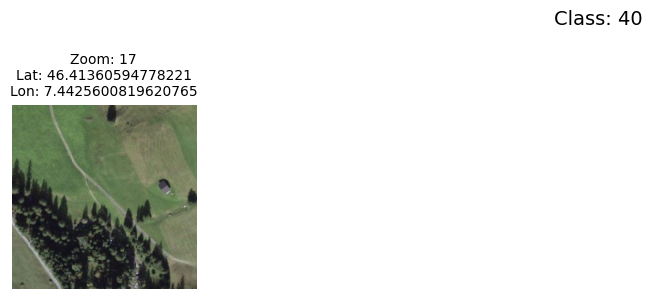

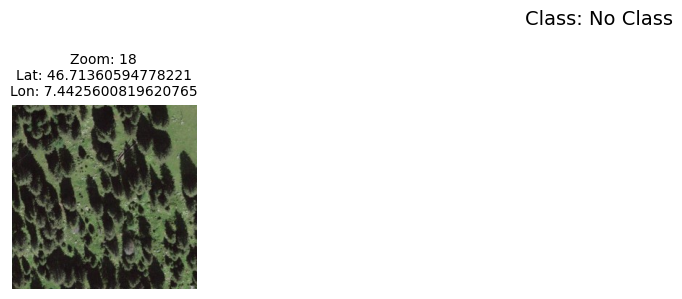

In [ ]:
# Example for one image
# https://wmts100.geo.admin.ch/1.0.0/ch.swisstopo.swissimage/default/current/2056/28/7043/6890.jpeg
# https://wmts100.geo.admin.ch/1.0.0/ch.swisstopo.swissimage/default/current/2056/27/2817/2756.jpeg
# https://wmts100.geo.admin.ch/1.0.0/ch.swisstopo.swissimage/default/current/2056/26/1408/1377.jpeg
img_coord = [
    (46.41360594778221, 7.4425600819620765, 40),  # With class value
    (46.71360594778221, 7.4425600819620765)       # Without class value
]

zoom_levels_example = [17, 18]

example_images = fetch_images_with_random_zoom_levels(img_coord, zoom_levels_example)

# Show images grouped by class
show_images_grouped_by_class(img_coord, example_images)

Fetch the images from the given coordinates in the dataset

In [ ]:
# Fetch the images
fetched_images = fetch_images_with_random_zoom_levels(coordinates, zoom_levels)

Fetching Images: 100%|██████████| 3600/3600 [20:23<00:00,  2.94it/s]


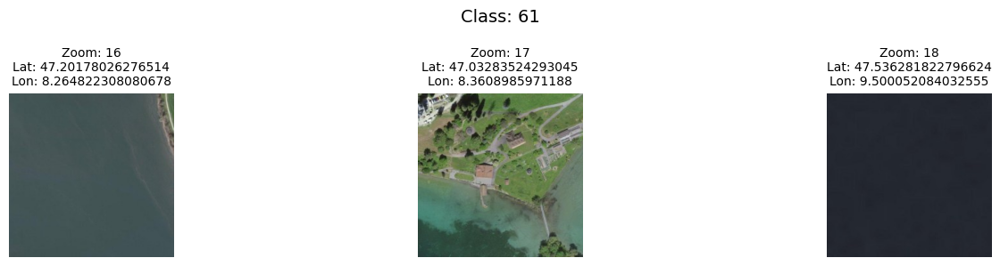

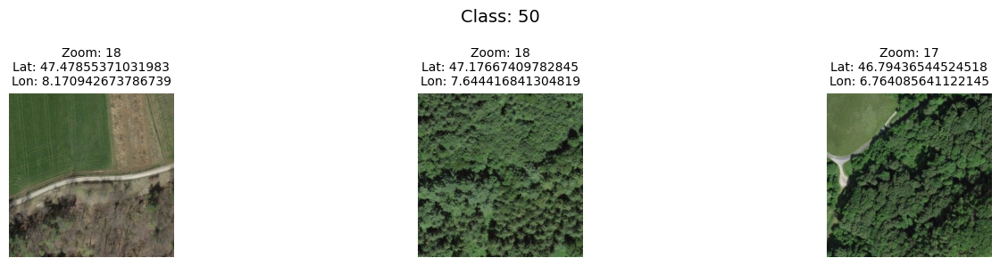

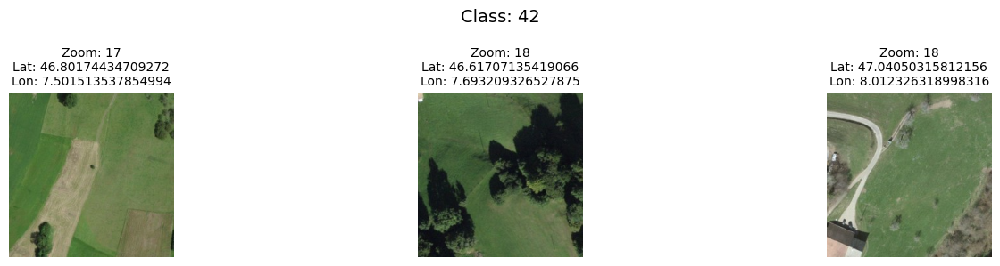

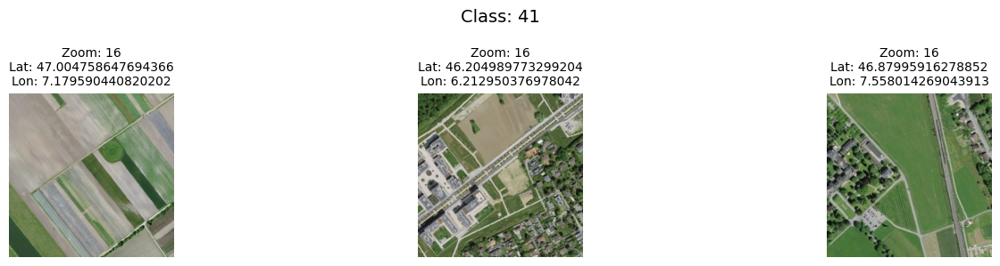

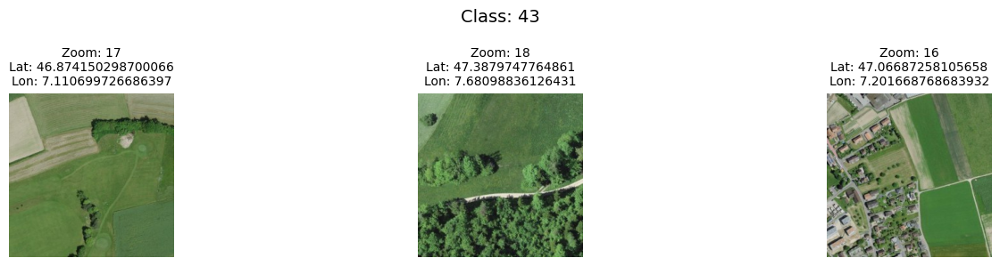

...

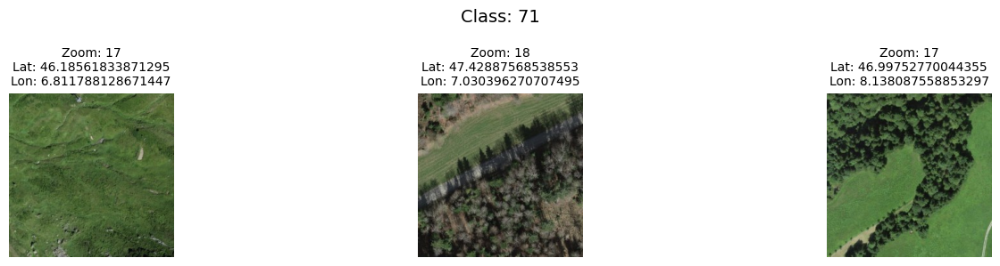

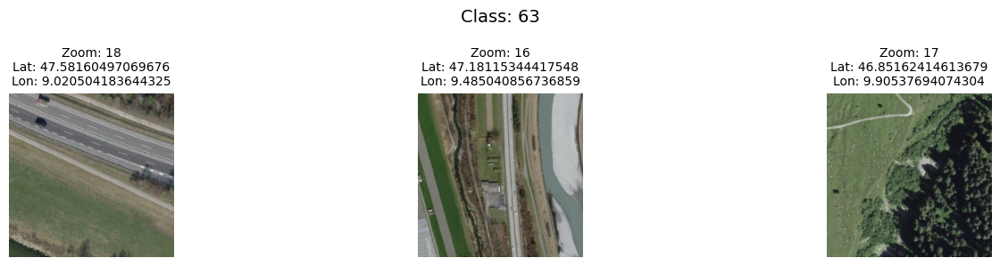

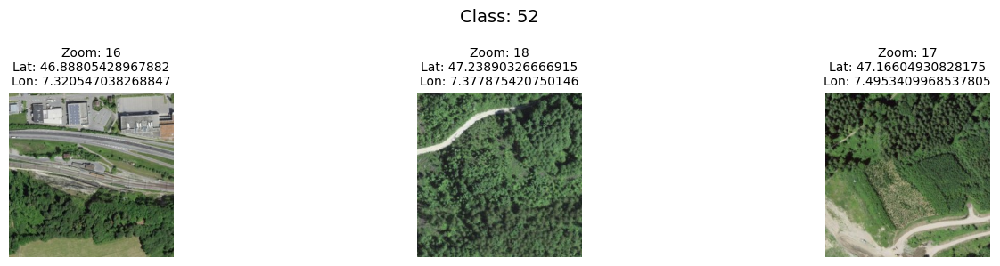

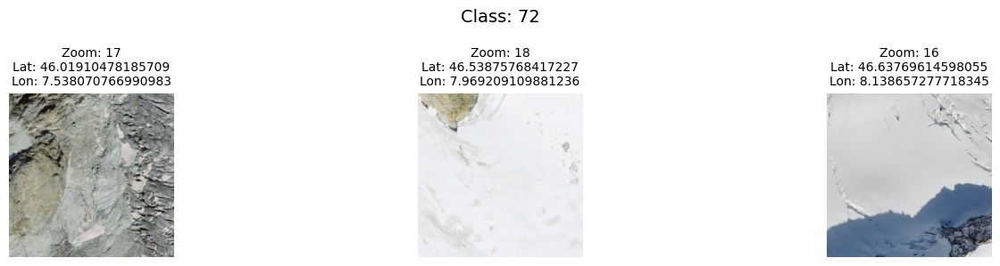

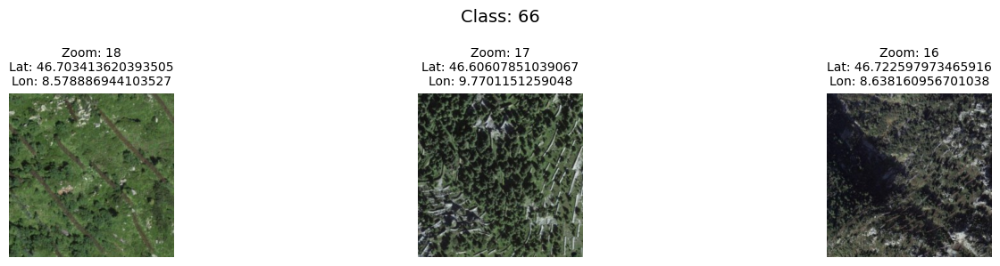

In [ ]:
# Show images grouped by class
show_images_grouped_by_class(coordinates, fetched_images)